In [1]:
!pip install sklearn matplotlib pandas numpy autograd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for sklearn: filename=sklearn-0.0.post1-py3-none-any.whl size=2344 sha256=cc74fbb566906e43266f359ae7d8dc9e900ec0c2bc46e853b88cffbdf43a0931
  Stored in directory: /root/.cache/pip/wheels/42/56/cc/4a8bf86613aafd5b7f1b310477667c1fca5c51c3ae4124a003
Successfully built sklearn


In [34]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
import os

def unpickle(file):
    with open(file, 'rb') as fo:
        dict = pickle.load(fo, encoding='latin1')
    return dict

def load_cifar_data(file_dir):
    train_data_dict = unpickle(os.path.join(file_dir, "train"))
    test_data_dict = unpickle(os.path.join(file_dir, "test"))
    x_train = train_data_dict["data"].reshape(50000, 3, 32, 32).transpose(0,2,3,1).astype("uint8")
    x_test = test_data_dict["data"].reshape(10000, 3, 32, 32).transpose(0,2,3,1).astype("uint8")
    return x_train, x_test

# flattern cifar data from N*32*32*3 to N*3072
def flattern_data(x):
    samples = x.shape[0]
    flattern_shape = 1
    for dim in x.shape[1:]:
        flattern_shape *= dim
    return x.reshape(samples, flattern_shape)

# reconstruct data from N*3072 to N*32*32*3
def construct_image_from_flattern(x, colored = True):
    samples = x.shape[0]
    if colored:
      return x.reshape(samples, 32, 32, 3).astype("uint8")
    else:
      return x.reshape(samples, 32, 32).astype("uint8")

#visualize image data, displayed on row*col grid, x's 1st-dim >= (row*col)
def visualize_data(row, col, plt_size, x):
    fig, axes1 = plt.subplots(row, col, figsize=(plt_size, plt_size))
    i = 0
    for j in range(row):
        for k in range(col):
            if i >= len(x):
              break
            axes1[j][k].set_axis_off()
            axes1[j][k].imshow(x[i])
            i += 1
    plt.show()
    return

In [7]:
from sklearn.decomposition import PCA

# construct a pca object from given data
def get_pca(component, X):
    pca = PCA(n_components=component)
    pca.fit(X)
    return pca

def pca_encode(pca_model, X):
  return pca_model.transform(X)

def pca_decode(pca_model, X):
  return pca_model.inverse_transform(X)

In [4]:
from sklearn.cluster import KMeans

# generate a kmeans model and label of input data
def generate_kmeans_model(X, k):
    kmeans = KMeans(n_clusters=k, random_state=0)
    transformed = kmeans.fit_predict(X)
    return kmeans, transformed

# predict cluster labels of given data
def kmeans_clustering(model, X):
    return model.predict(X)

# transform a list of labels respect to index into a dictionary of {cluster)num:[index]}
def clusters_to_index(cluster_labels):
    dict = {}
    for i in range(len(cluster_labels)):
        if cluster_labels[i] in dict:
            dict[cluster_labels[i]].append(i)
        else:
            dict[cluster_labels[i]] = [i]
    return dict

In [24]:
def pca_kmeans_pipeline(X, feature_vector_size, cluster_num):
  pca_model = get_pca(feature_vector_size, X)
  encoded_image = pca_encode(pca_model, X)
  kmeans_model, data_index_cluster_labels = generate_kmeans_model(encoded_image, cluster_num)
  cluster_index_dict = clusters_to_index(data_index_cluster_labels)
  return pca_model, kmeans_model, cluster_index_dict

In [40]:
# visualizing kmeans cluster centers
def visualize_kmeans_centre(kmeans_model, pca_model, row, col, colored = True):
  cluster_centers = kmeans_model.cluster_centers_
  cluster_centers_decoded = pca_decode(pca_model, cluster_centers)
  cluster_centers_decoded_image = construct_image_from_flattern(cluster_centers_decoded, colored)
  visualize_data(row, col, 15, cluster_centers_decoded_image)


In [6]:
x_train_2d_3channel, x_test_2d_3channel = load_cifar_data(".")
x_train_flattern = flattern_data(x_train_2d_3channel)
x_test_flattern = flattern_data(x_test_2d_3channel)

In [26]:
feature_vector_size = 500
n_cluster = 100
pca_model, kmeans_model, cluster_index_dict = pca_kmeans_pipeline(x_train_flattern, feature_vector_size, n_cluster)

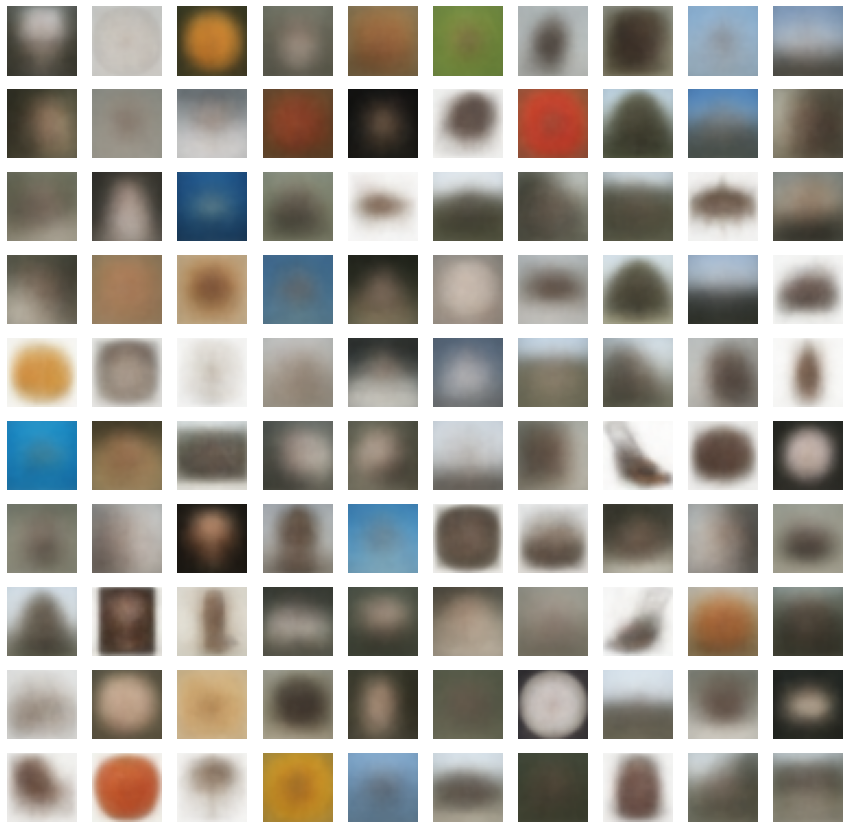

In [41]:
visualize_kmeans_centre(kmeans_model, pca_model, 10, 10)

0


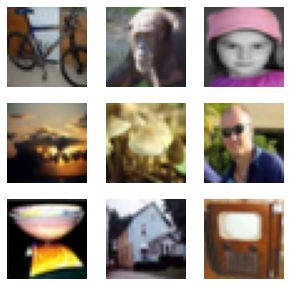

1


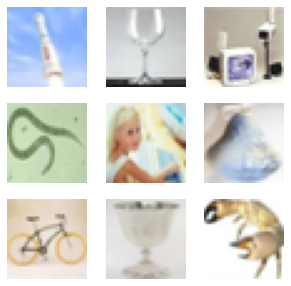

2


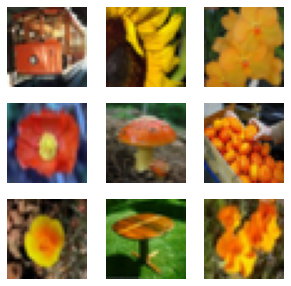

3


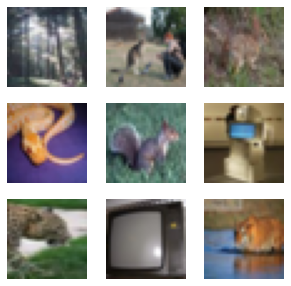

4


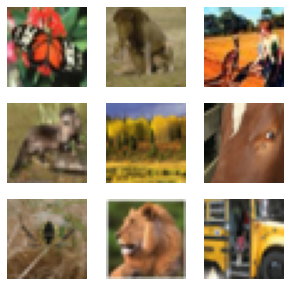

5


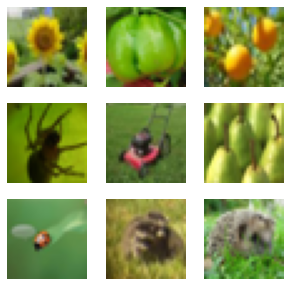

6


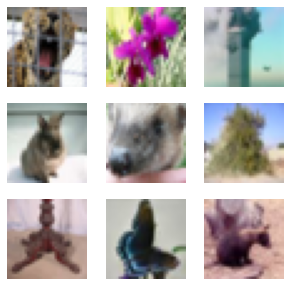

7


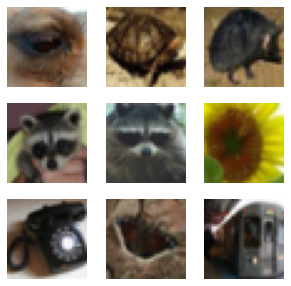

8


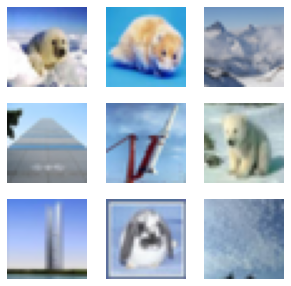

9


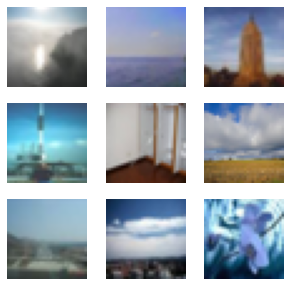

10


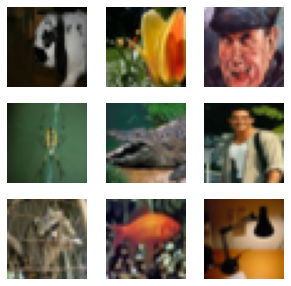

11


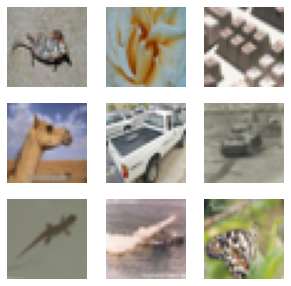

12


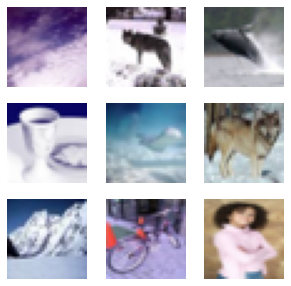

13


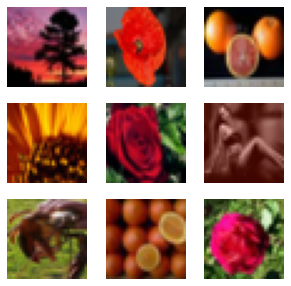

14


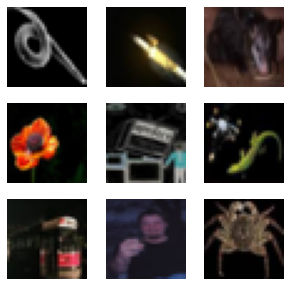

15


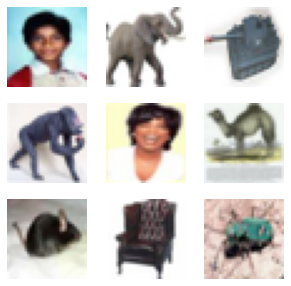

16


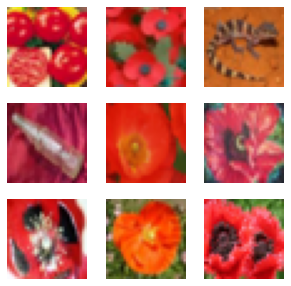

17


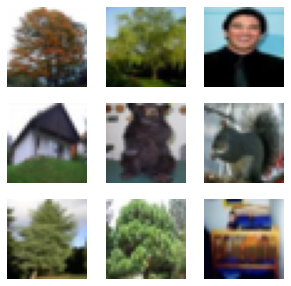

18


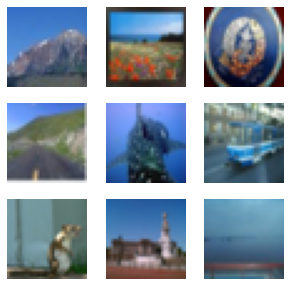

19


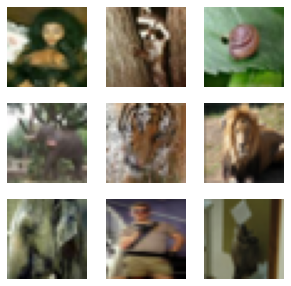

20


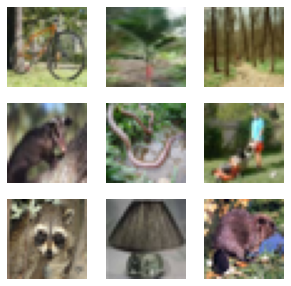

21


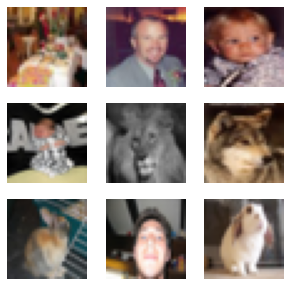

22


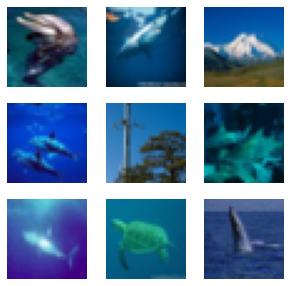

23


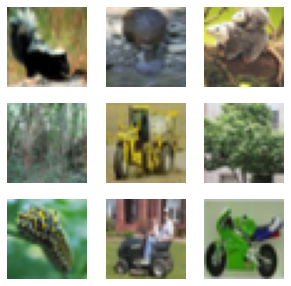

24


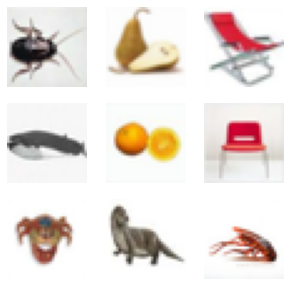

25


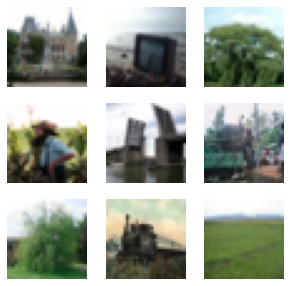

26


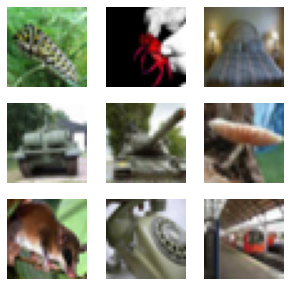

27


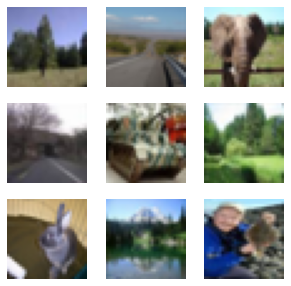

28


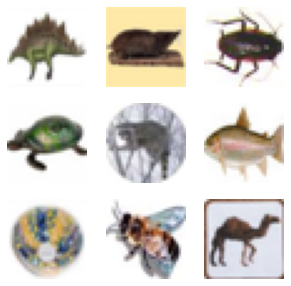

29


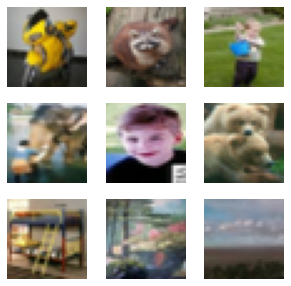

30


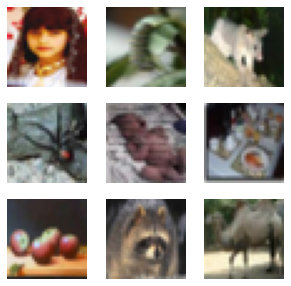

31


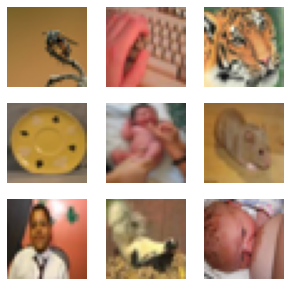

32


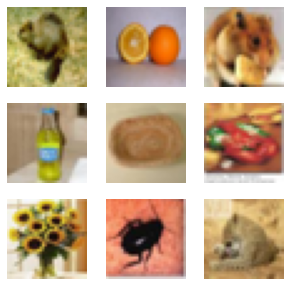

33


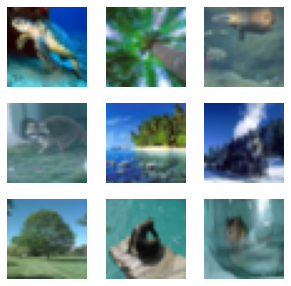

34


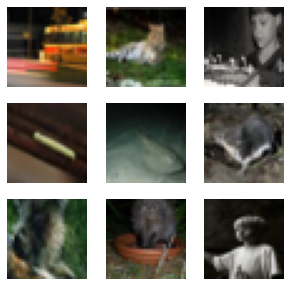

35


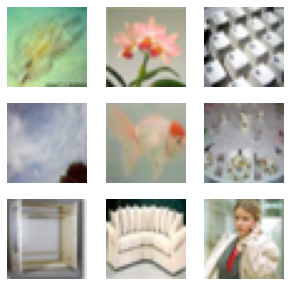

36


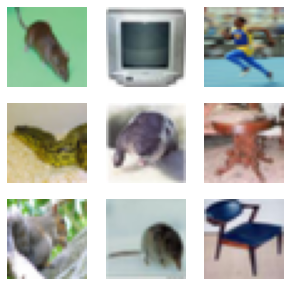

37


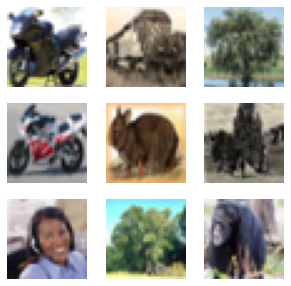

38


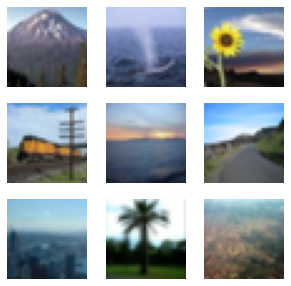

39


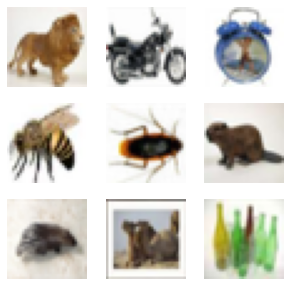

40


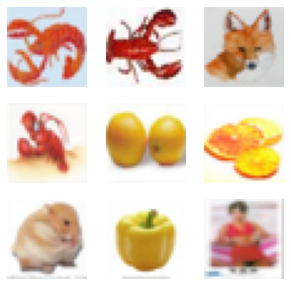

41


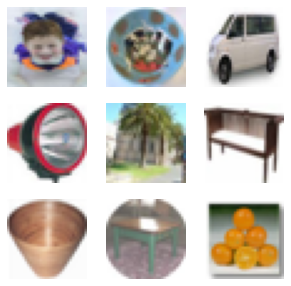

42


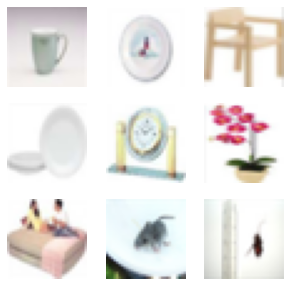

43


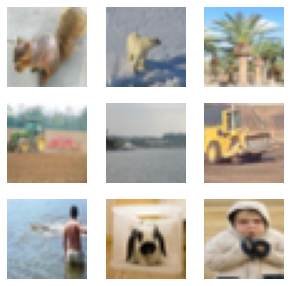

44


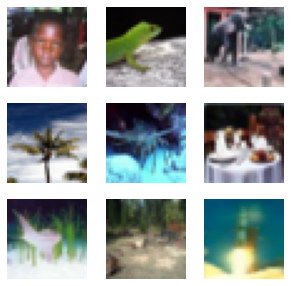

45


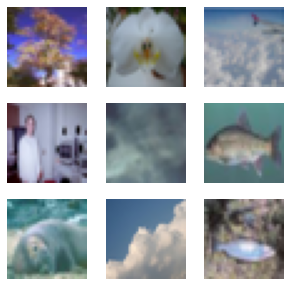

46


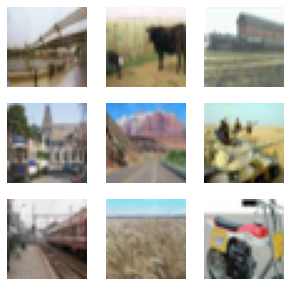

47


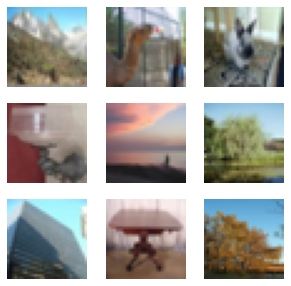

48


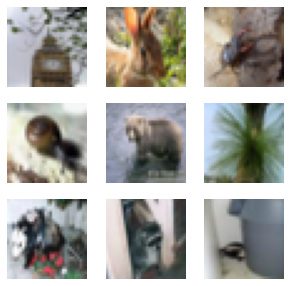

49


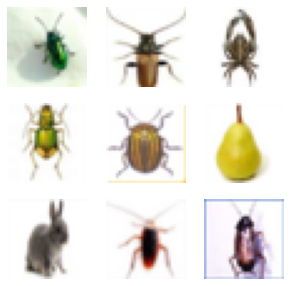

50


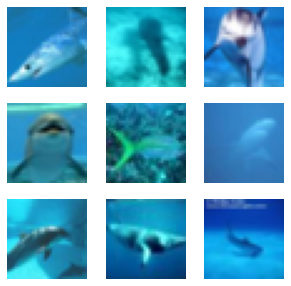

51


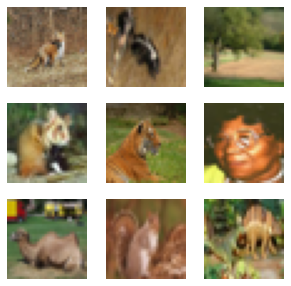

52


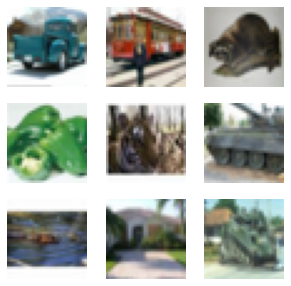

53


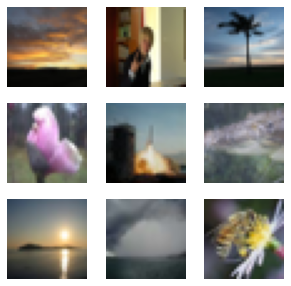

54


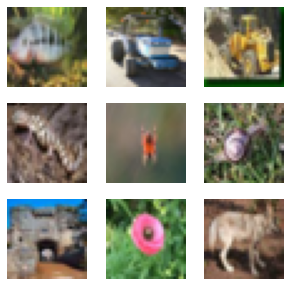

55


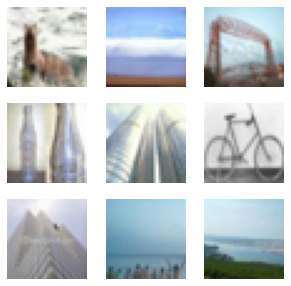

56


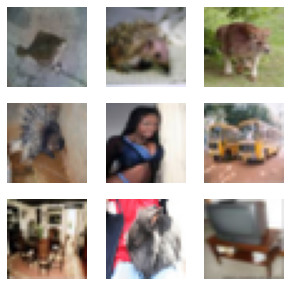

57


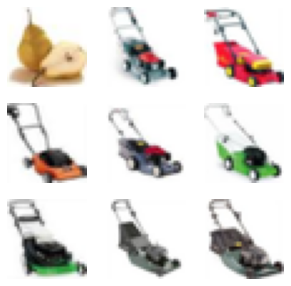

58


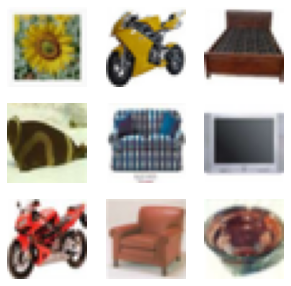

59


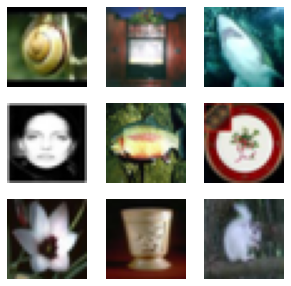

60


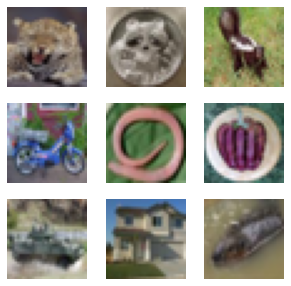

61


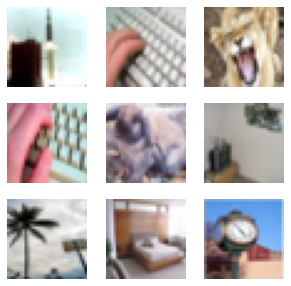

62


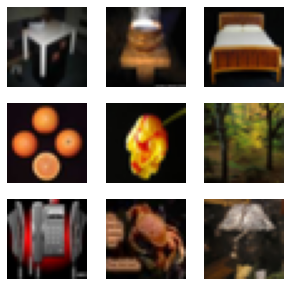

63


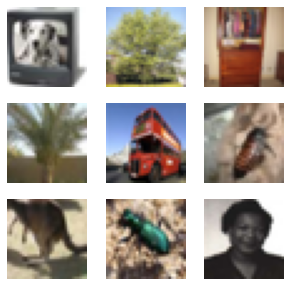

64


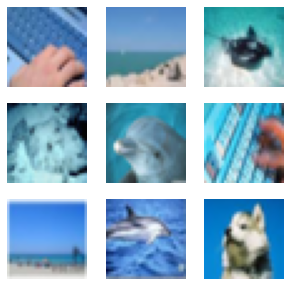

65


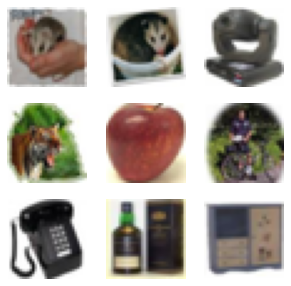

66


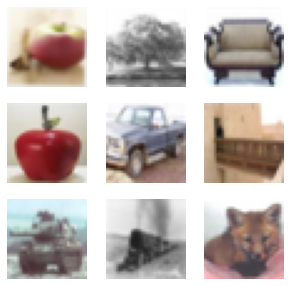

67


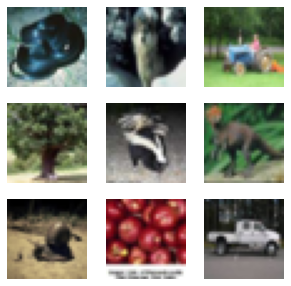

68


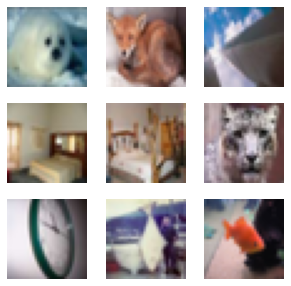

69


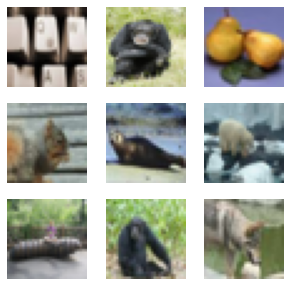

70


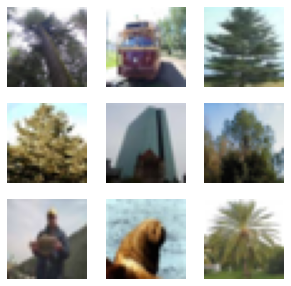

71


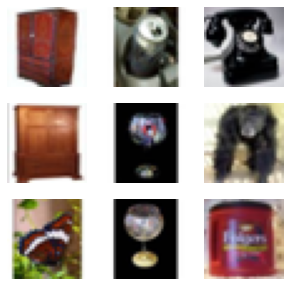

72


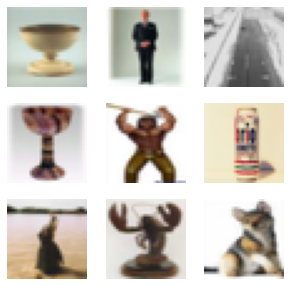

73


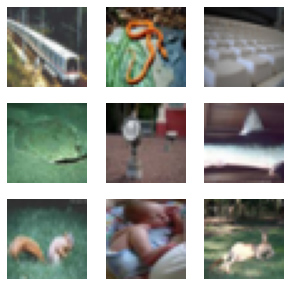

74


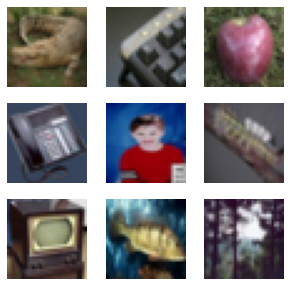

75


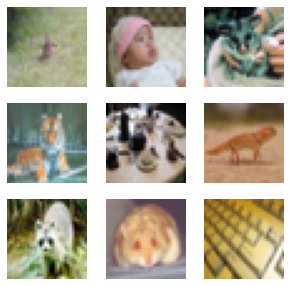

76


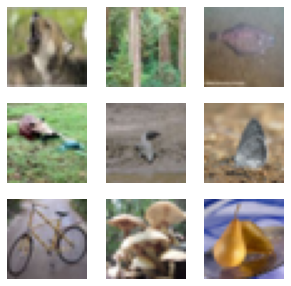

77


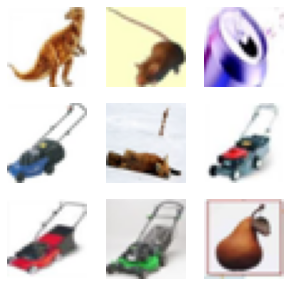

78


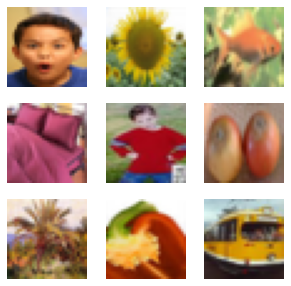

79


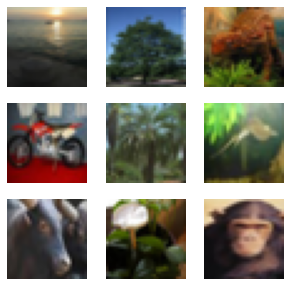

80


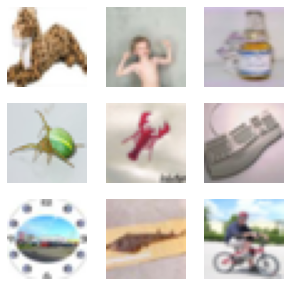

81


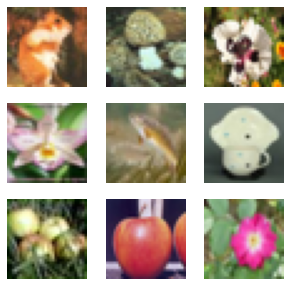

82


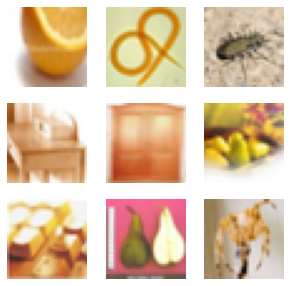

83


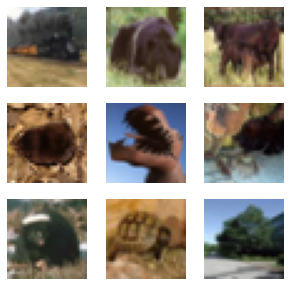

84


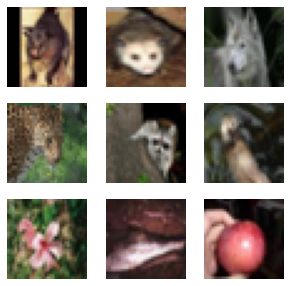

85


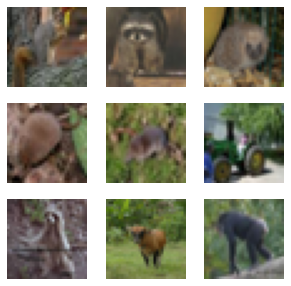

86


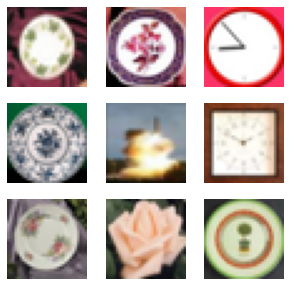

87


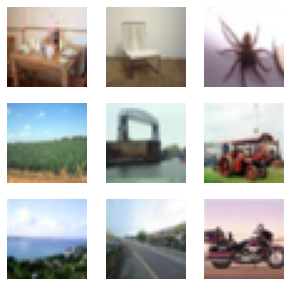

88


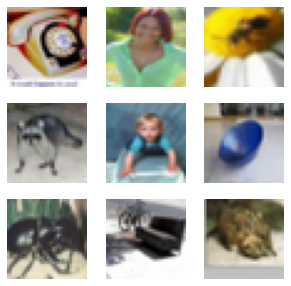

89


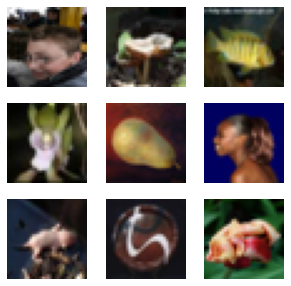

90


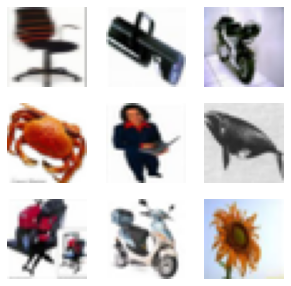

91


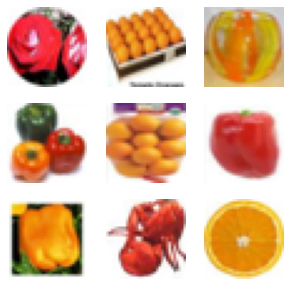

92


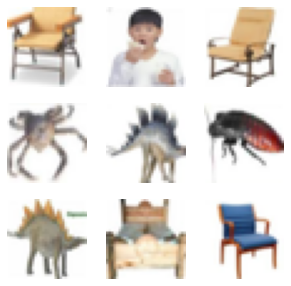

93


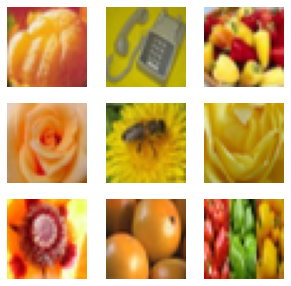

94


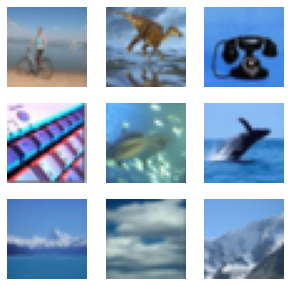

95


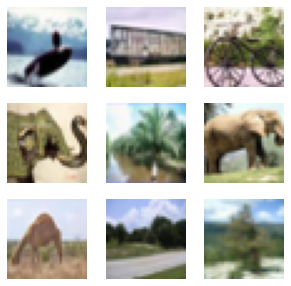

96


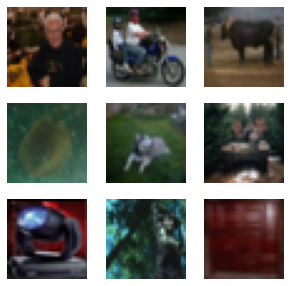

97


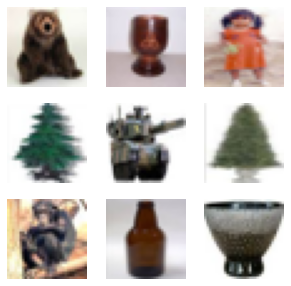

98


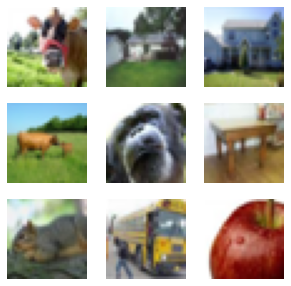

99


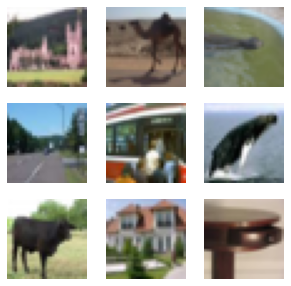

In [37]:
# Vidualize image clusters
for cluster in sorted(list(cluster_index_dict.keys())):
  print(cluster)
  image_index = cluster_index_dict[cluster]
  images = x_train_2d_3channel[image_index]
  visualize_data(3,3, 5, images)

In [30]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])

x_train_2d_gray = rgb2gray(x_train_2d_3channel)
x_train_gray_flattern = flattern_data(x_train_2d_gray)
pca_model_gray, kmeans_model_gray, cluster_index_dict_gray = pca_kmeans_pipeline(x_train_gray_flattern, feature_vector_size, n_cluster)

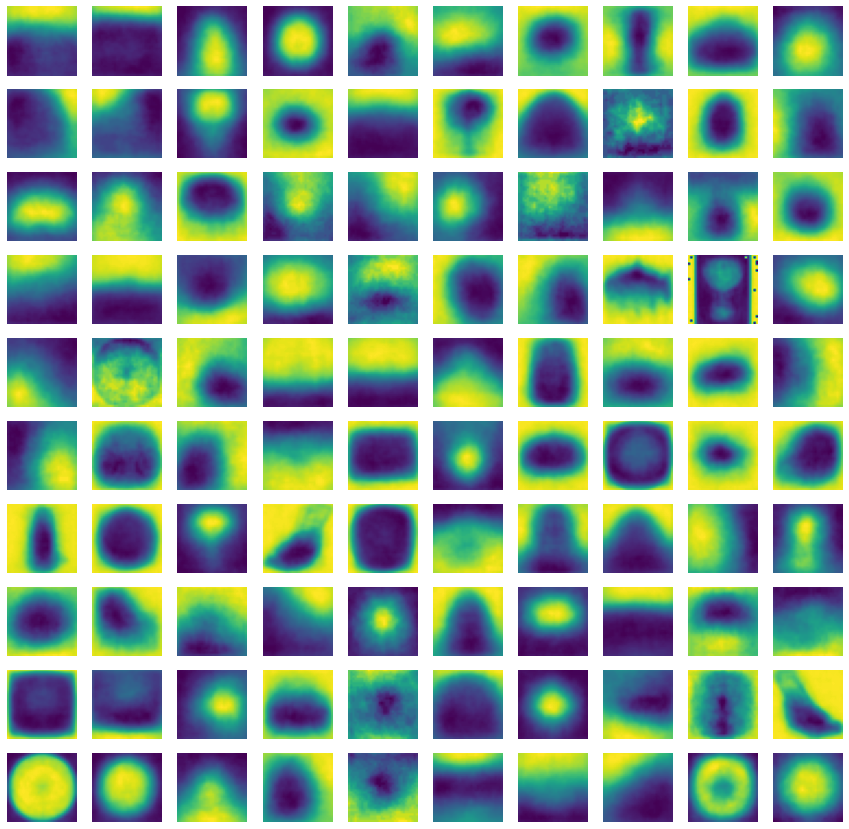

In [42]:
visualize_kmeans_centre(kmeans_model_gray, pca_model_gray, 10, 10, colored = False)

0


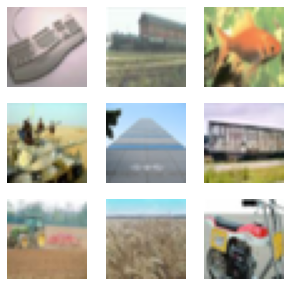

1


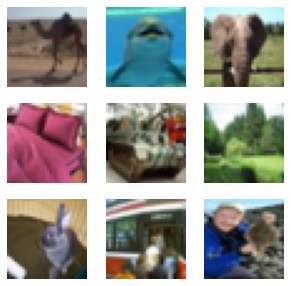

2


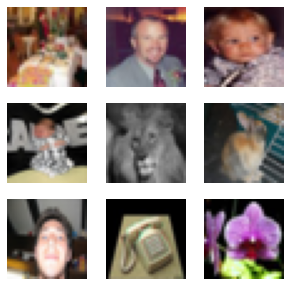

3


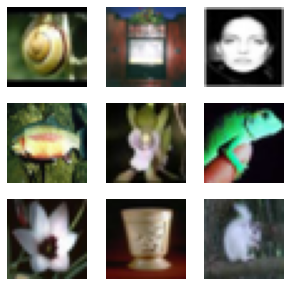

4


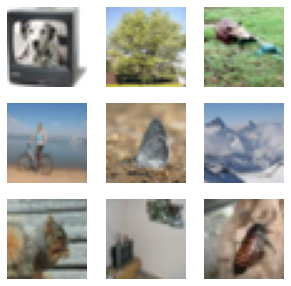

5


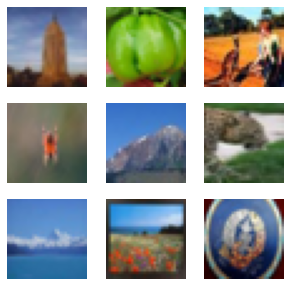

6


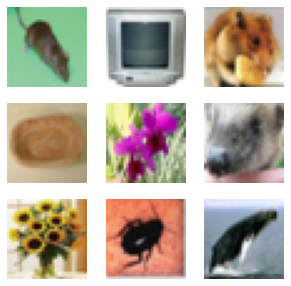

7


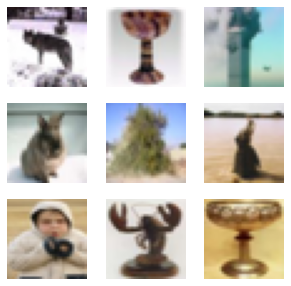

8


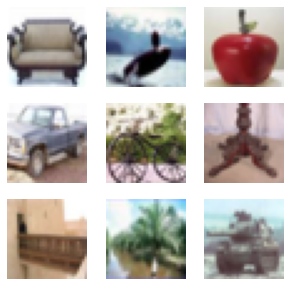

9


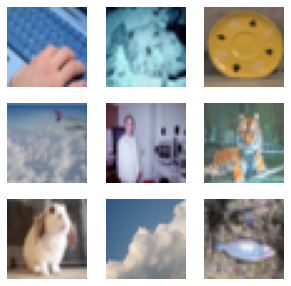

10


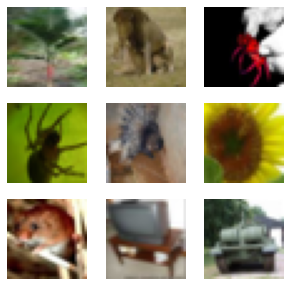

11


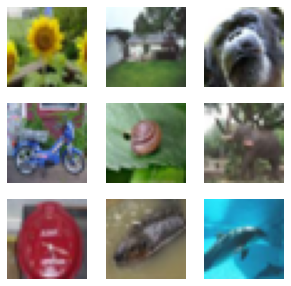

12


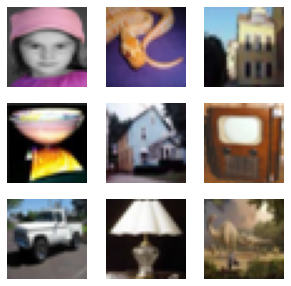

13


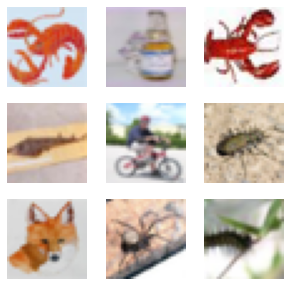

14


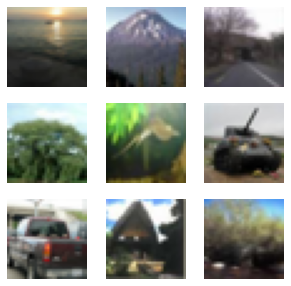

15


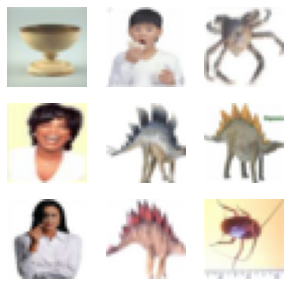

16


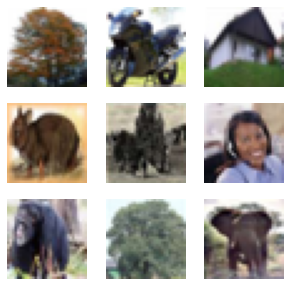

17


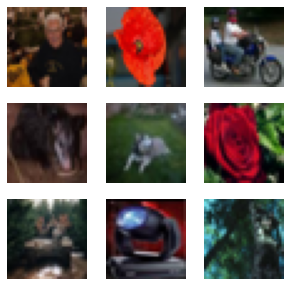

18


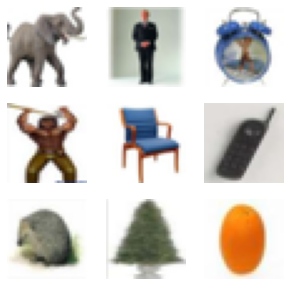

19


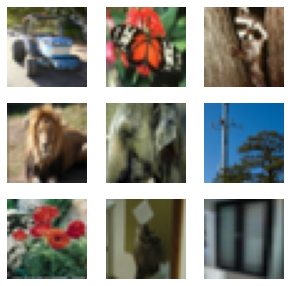

20


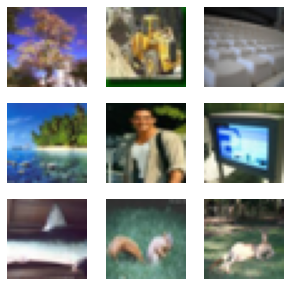

21


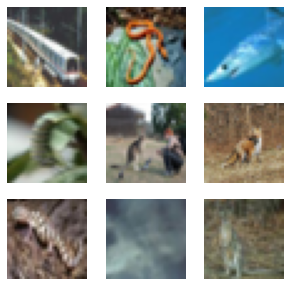

22


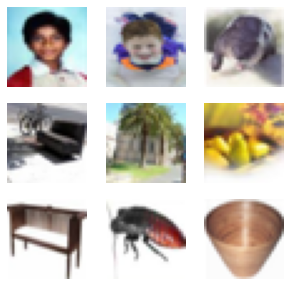

23


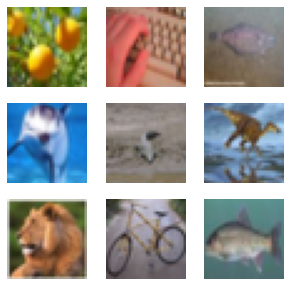

24


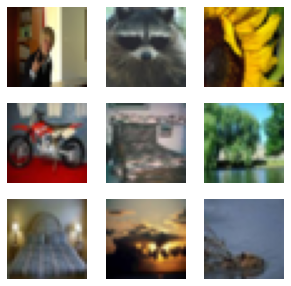

25


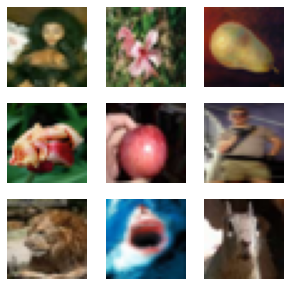

26


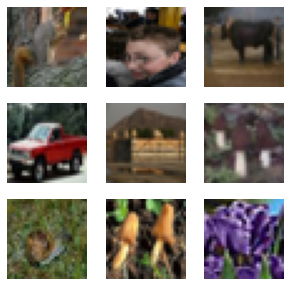

27


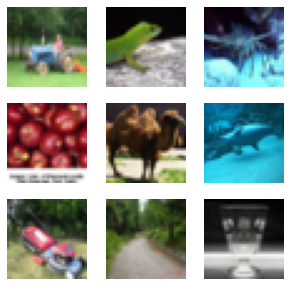

28


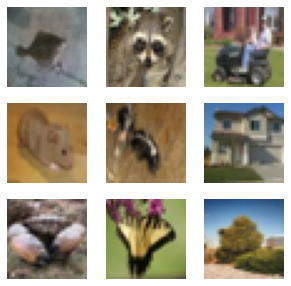

29


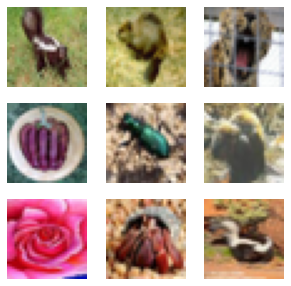

30


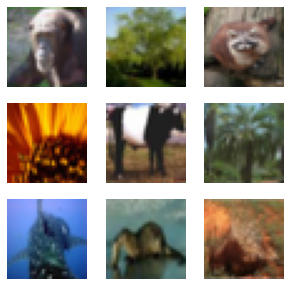

31


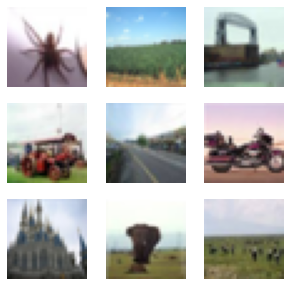

32


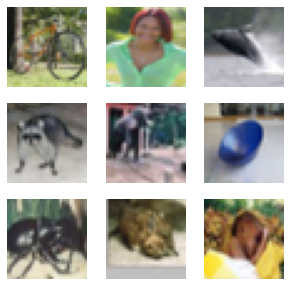

33


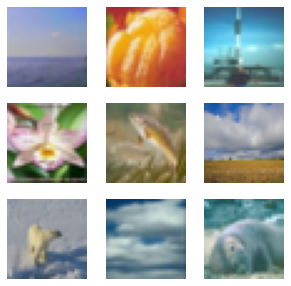

34


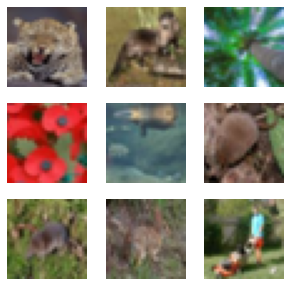

35


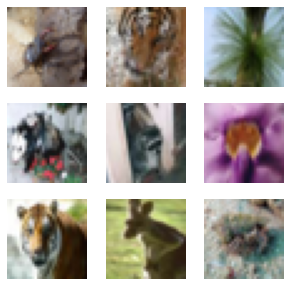

36


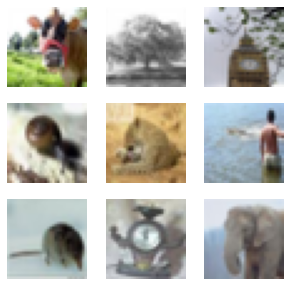

37


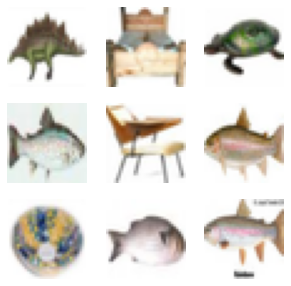

38


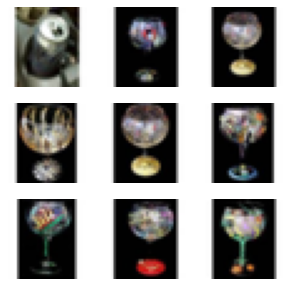

39


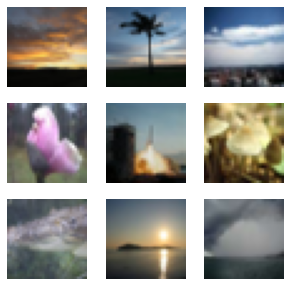

40


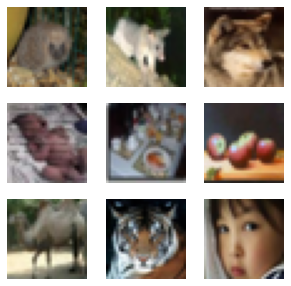

41


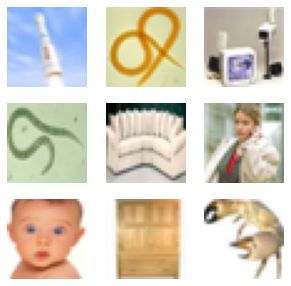

42


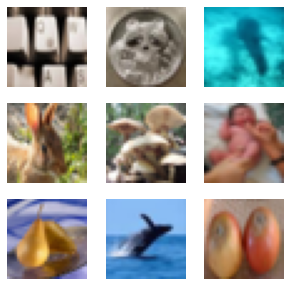

43


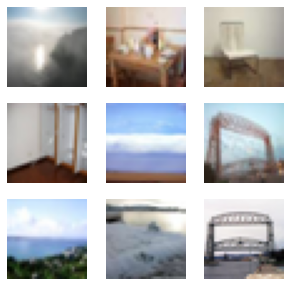

44


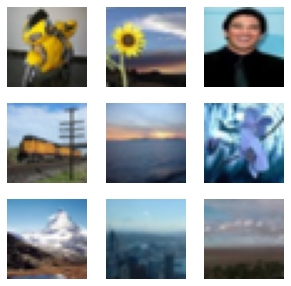

45


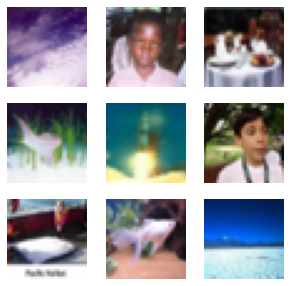

46


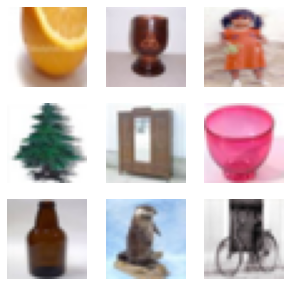

47


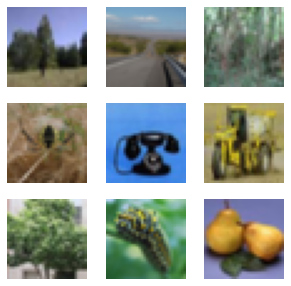

48


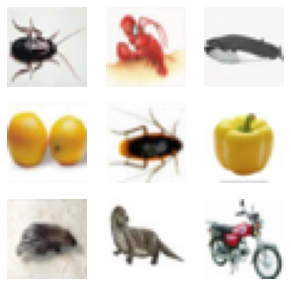

49


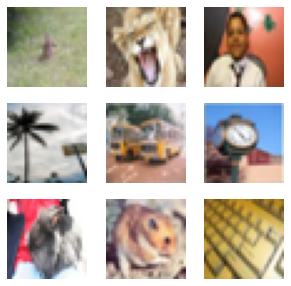

50


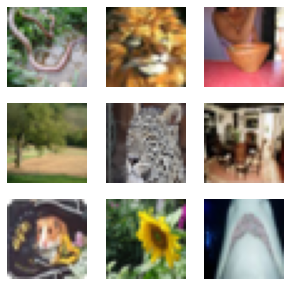

51


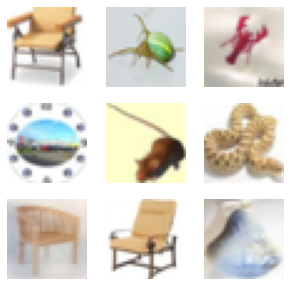

52


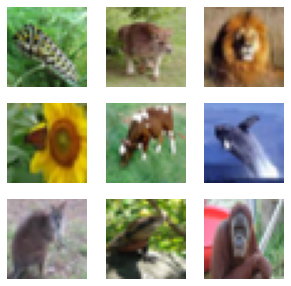

53


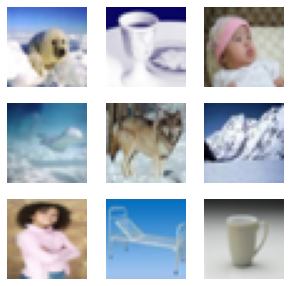

54


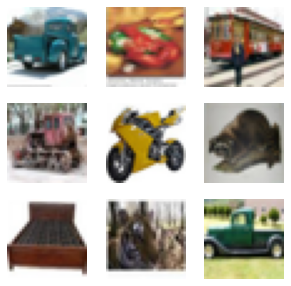

55


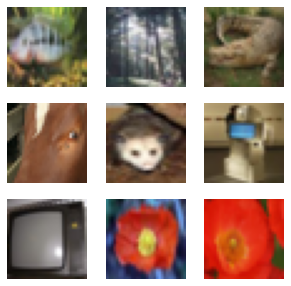

56


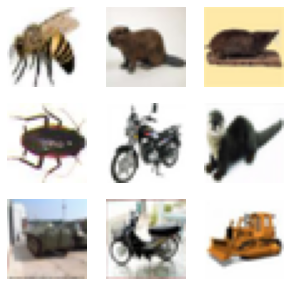

57


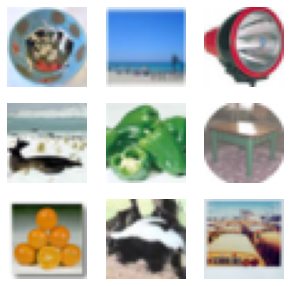

58


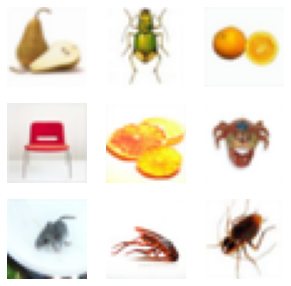

59


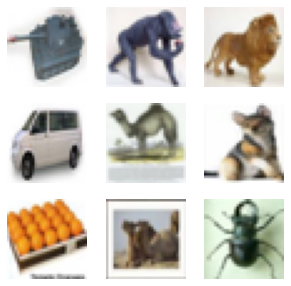

60


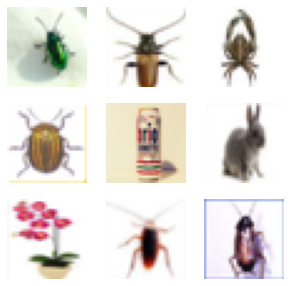

61


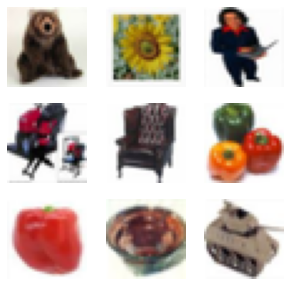

62


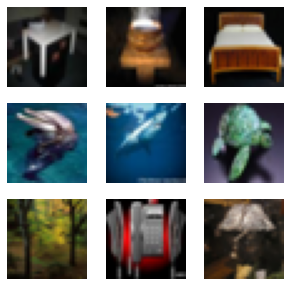

63


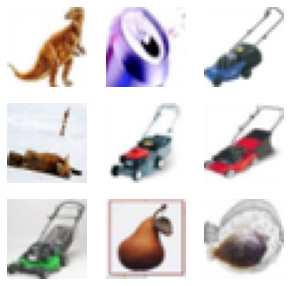

64


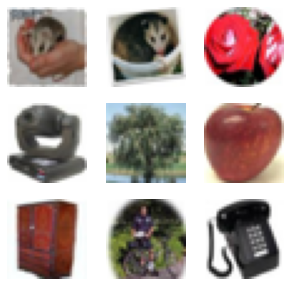

65


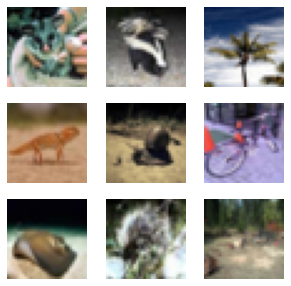

66


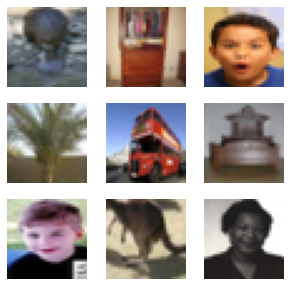

67


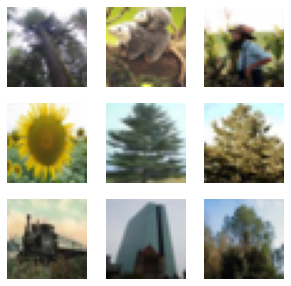

68


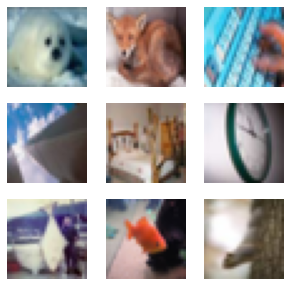

69


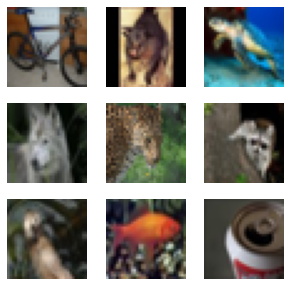

70


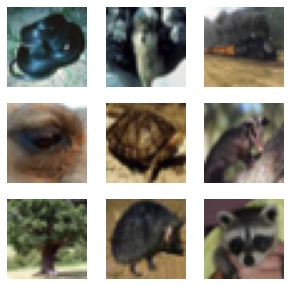

71


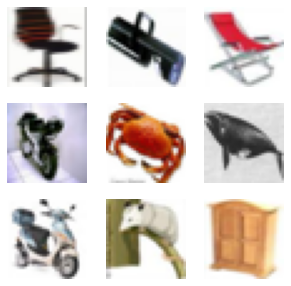

72


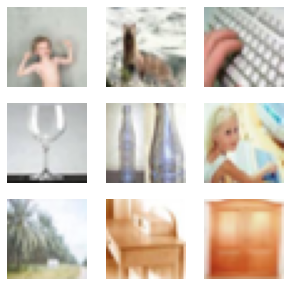

73


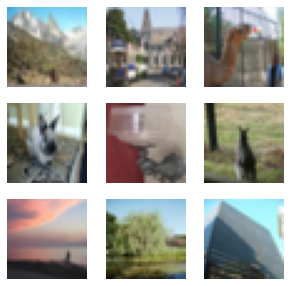

74


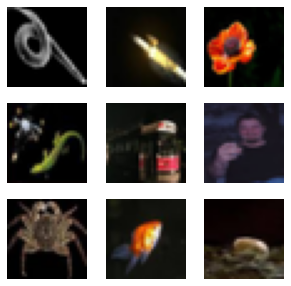

75


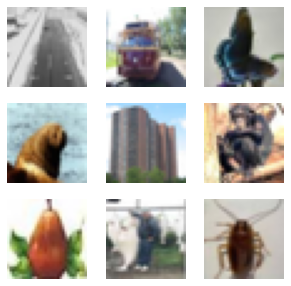

76


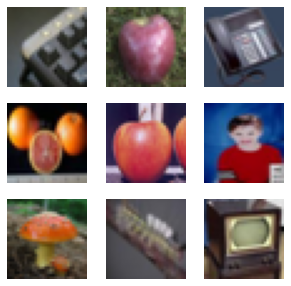

77


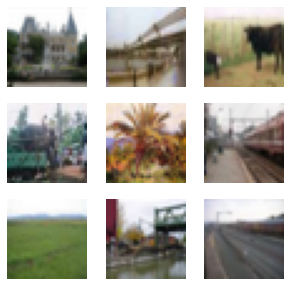

78


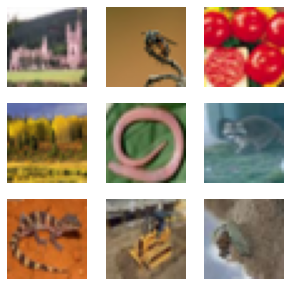

79


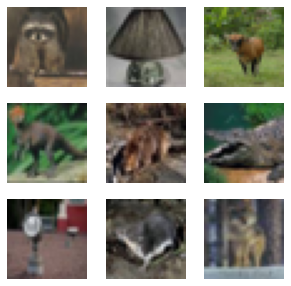

80


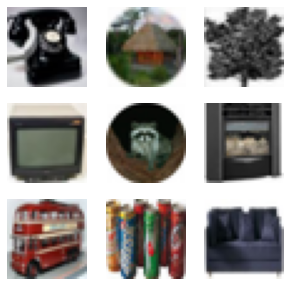

81


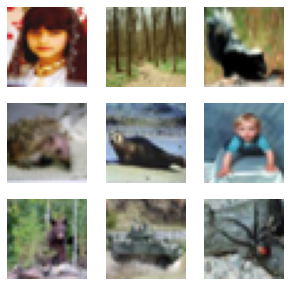

82


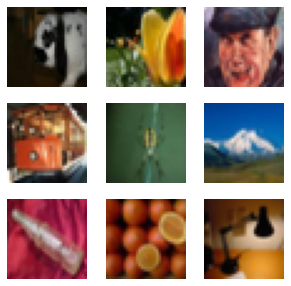

83


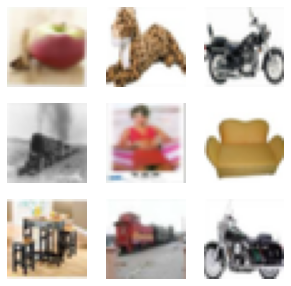

84


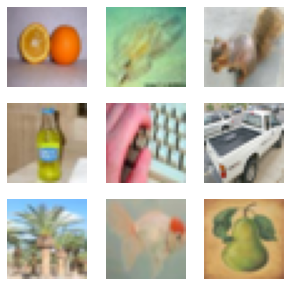

85


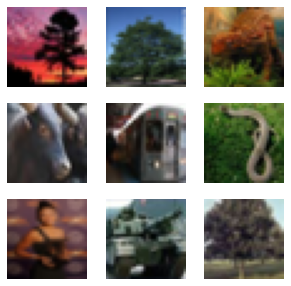

86


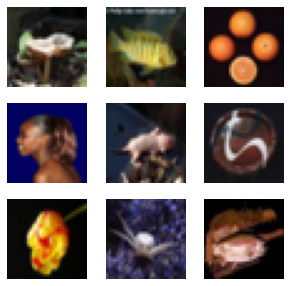

87


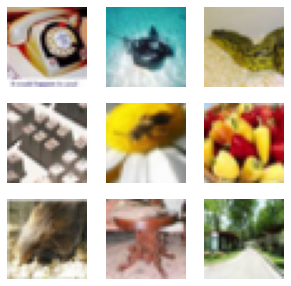

88


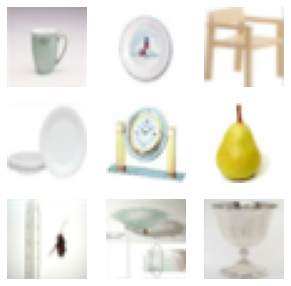

89


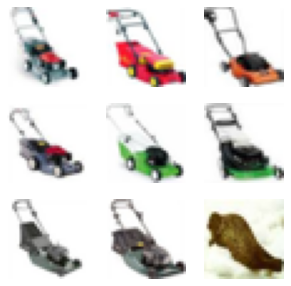

90


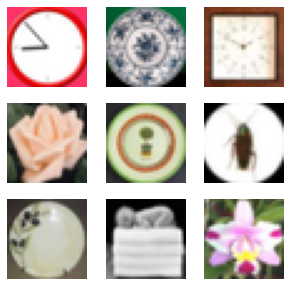

91


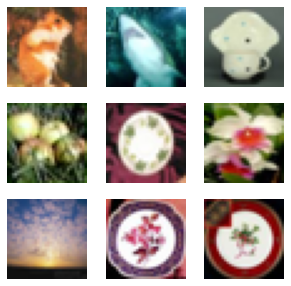

92


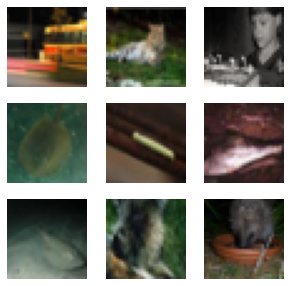

93


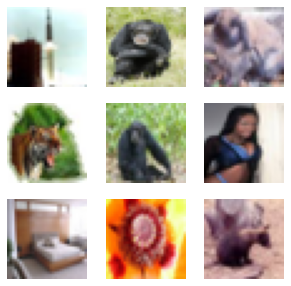

94


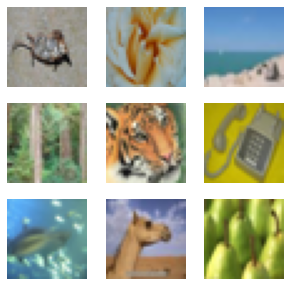

95


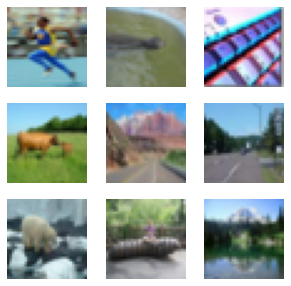

96


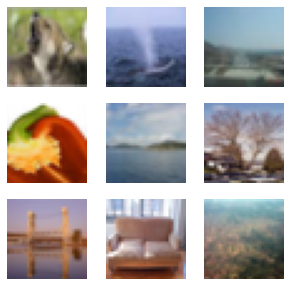

97


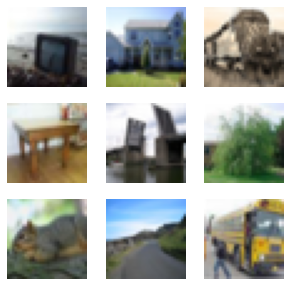

98


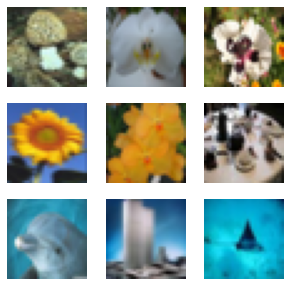

99


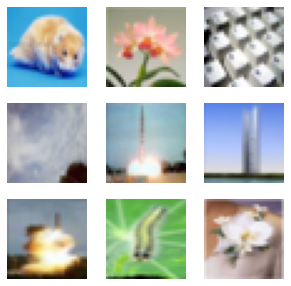

In [38]:
for cluster in sorted(list(cluster_index_dict_gray.keys())):
  print(cluster)
  image_index = cluster_index_dict_gray[cluster]
  images = x_train_2d_3channel[image_index]
  visualize_data(3,3, 5, images)